In [1]:
import pandas as pd
from tqdm import tqdm
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud

from collections import Counter
import itertools 

## Погдотовка датасета

Изначально при обработке текста лемматизированный текст был сохранен в виде списков. Для дальнейших экспериментов он требуется в виде строки, состоящей из лемматизированых слов.

In [2]:
df = pd.read_csv('E:\\!docum\\!HSE магистратура\\Задание проект\\обработанные данные\\lenta-ru-news_full.csv')

In [3]:
df

,url,title,text,topic,tags,date,text_lemmatize
0,https://lenta.ru/news/1999/08/31/stancia_mir/,"Космонавты сомневаются в надежности ""Мира""",Как стало известно агентству Ассошиэйтед Пресс...,Россия,Все,1999-08-31 00:00:00,"['стать', 'известно', 'агентство', 'ассошиэйте..."
1,https://lenta.ru/news/1999/08/31/vzriv/,Взрыв в центре Москвы: пострадало 30 человек,В зале игровых автоматов в третьем ярусе подзе...,Россия,Все,1999-08-31 00:00:00,"['зал', 'игровые', 'автоматы', 'третий', 'ярус..."
2,https://lenta.ru/news/1999/08/31/credit_japs/,Япония кредитует Россию на полтора миллиарда д...,Япония приняла решение разморозить кредиты Рос...,Россия,Все,1999-08-31 00:00:00,"['япония', 'принять', 'решение', 'разморозить'..."
3,https://lenta.ru/news/1999/08/31/diana/,Британцы отмечают двухлетие смерти Дианы,Британцы отмечают сегодня скорбную дату - втор...,Мир,Все,1999-08-31 00:00:00,"['британцы', 'отмечать', 'сегодня', 'скорбная'..."
4,https://lenta.ru/news/1999/08/31/mvf/,Отмытые через Bank of NY деньги не имели отнош...,В понедельник директор департамента внешних св...,Россия,Все,1999-08-31 00:00:00,"['понедельник', 'директор', 'департамент', 'вн..."
...,...,...,...,...,...,...,...
1156523,https://lenta.ru/news/2022/11/18/bezhh/,Беженца из Украины избили после спора о нацистах,Беженца из Украины избили в городе Кейзер амер...,Мир,Общество,2022/11/18,"['беженец', 'украина', 'избить', 'город', 'кей..."
1156524,https://lenta.ru/news/2022/11/18/nurmagomedov/,Брат Нурмагомедова назвал цель выступления в B...,"Российский боец смешанного стиля (ММА), двоюро...",Спорт,Бокс и ММА,2022/11/18,"['российский', 'боец', 'смешанный', 'стиль', '..."
1156525,https://lenta.ru/news/2022/11/18/bioprint/,Разработана технология печати ткани для трансп...,Ученые Израильского технологического института...,Наука и техника,Будущее,2022/11/18,"['учёные', 'израильское', 'технологическое', '..."
1156526,https://lenta.ru/news/2022/11/18/penni/,Республиканцы в Конгрессе потребовали проверит...,Республиканцы в Палате представителей конгресс...,Мир,Политика,2022/11/18,"['республиканцы', 'палата', 'представители', '..."


In [5]:
df.drop('text', axis=1, inplace=True)

In [6]:
df

,url,title,topic,tags,date,text_lemmatize
0,https://lenta.ru/news/1999/08/31/stancia_mir/,"Космонавты сомневаются в надежности ""Мира""",Россия,Все,1999-08-31 00:00:00,"['стать', 'известно', 'агентство', 'ассошиэйте..."
1,https://lenta.ru/news/1999/08/31/vzriv/,Взрыв в центре Москвы: пострадало 30 человек,Россия,Все,1999-08-31 00:00:00,"['зал', 'игровые', 'автоматы', 'третий', 'ярус..."
2,https://lenta.ru/news/1999/08/31/credit_japs/,Япония кредитует Россию на полтора миллиарда д...,Россия,Все,1999-08-31 00:00:00,"['япония', 'принять', 'решение', 'разморозить'..."
3,https://lenta.ru/news/1999/08/31/diana/,Британцы отмечают двухлетие смерти Дианы,Мир,Все,1999-08-31 00:00:00,"['британцы', 'отмечать', 'сегодня', 'скорбная'..."
4,https://lenta.ru/news/1999/08/31/mvf/,Отмытые через Bank of NY деньги не имели отнош...,Россия,Все,1999-08-31 00:00:00,"['понедельник', 'директор', 'департамент', 'вн..."
...,...,...,...,...,...,...
1156523,https://lenta.ru/news/2022/11/18/bezhh/,Беженца из Украины избили после спора о нацистах,Мир,Общество,2022/11/18,"['беженец', 'украина', 'избить', 'город', 'кей..."
1156524,https://lenta.ru/news/2022/11/18/nurmagomedov/,Брат Нурмагомедова назвал цель выступления в B...,Спорт,Бокс и ММА,2022/11/18,"['российский', 'боец', 'смешанный', 'стиль', '..."
1156525,https://lenta.ru/news/2022/11/18/bioprint/,Разработана технология печати ткани для трансп...,Наука и техника,Будущее,2022/11/18,"['учёные', 'израильское', 'технологическое', '..."
1156526,https://lenta.ru/news/2022/11/18/penni/,Республиканцы в Конгрессе потребовали проверит...,Мир,Политика,2022/11/18,"['республиканцы', 'палата', 'представители', '..."


In [8]:
part1 = len(df.text_lemmatize) // 2
part2 = len(df.text_lemmatize) - (len(df.text_lemmatize) // 2)
part1 + part2 == len(df.text_lemmatize)

True

In [9]:
text_string = [' '.join(df.text_lemmatize[i].strip('][\'').split('\', \'')) for i in tqdm(range(part1))]

100%|███████████████████████████████████████████████████████████████████████| 578264/578264 [00:23<00:00, 24880.13it/s]


In [11]:
text_string2 = [' '.join(df.text_lemmatize[i].strip('][\'').split('\', \'')) for i in tqdm(range(part1, len(df.text_lemmatize)))]

100%|███████████████████████████████████████████████████████████████████████| 578264/578264 [00:24<00:00, 23469.46it/s]


In [12]:
text_string.extend(text_string2)

In [13]:
df['text_str'] = text_string 

In [15]:
df.drop('text_lemmatize', axis=1, inplace=True)

In [16]:
#df.to_csv('lenta_pymorphy_lemmas_str.csv')

## Визуализация "облако слов"

Также построем облако слов для всего датасета и для каждой категории таргета в отдельности.

In [2]:
df = pd.read_csv('lenta_pymorphy_lemmas_str.csv')

In [3]:
df.drop('Unnamed: 0', axis=1, inplace=True)
df

,url,title,topic,tags,date,text_str
0,https://lenta.ru/news/1999/08/31/stancia_mir/,"Космонавты сомневаются в надежности ""Мира""",Россия,Все,1999-08-31 00:00:00,стать известно агентство ассошиэйтед пресс эки...
1,https://lenta.ru/news/1999/08/31/vzriv/,Взрыв в центре Москвы: пострадало 30 человек,Россия,Все,1999-08-31 00:00:00,зал игровые автоматы третий ярус подземное ком...
2,https://lenta.ru/news/1999/08/31/credit_japs/,Япония кредитует Россию на полтора миллиарда д...,Россия,Все,1999-08-31 00:00:00,япония принять решение разморозить кредиты рос...
3,https://lenta.ru/news/1999/08/31/diana/,Британцы отмечают двухлетие смерти Дианы,Мир,Все,1999-08-31 00:00:00,британцы отмечать сегодня скорбная дата вторая...
4,https://lenta.ru/news/1999/08/31/mvf/,Отмытые через Bank of NY деньги не имели отнош...,Россия,Все,1999-08-31 00:00:00,понедельник директор департамент внешние связи...
...,...,...,...,...,...,...
1156523,https://lenta.ru/news/2022/11/18/bezhh/,Беженца из Украины избили после спора о нацистах,Мир,Общество,2022/11/18,беженец украина избить город кейзер американск...
1156524,https://lenta.ru/news/2022/11/18/nurmagomedov/,Брат Нурмагомедова назвал цель выступления в B...,Спорт,Бокс и ММА,2022/11/18,российский боец смешанный стиль мма двоюродный...
1156525,https://lenta.ru/news/2022/11/18/bioprint/,Разработана технология печати ткани для трансп...,Наука и техника,Будущее,2022/11/18,учёные израильское технологическое институт ра...
1156526,https://lenta.ru/news/2022/11/18/penni/,Республиканцы в Конгрессе потребовали проверит...,Мир,Политика,2022/11/18,республиканцы палата представители конгресс сш...


In [4]:
def draw_wordcloud(data, photo: bool, name=None):
    wordcloud = WordCloud(
            width = 1280,
            height = 720,
            background_color='white',
            max_words=100,
            max_font_size=200,
            scale=3,
            random_state=123, 
            colormap='twilight')

    wc = wordcloud.generate(data)
    fig = plt.figure(1, figsize=(20, 12))
    plt.axis('off')
    plt.imshow(wordcloud)
    if photo == True:
        plt.savefig(name, bbox_inches='tight')
    plt.show()

In [5]:
def wordcloud_by_topic(topic):
    df_topic_f = df[df['topic'] == topic]
    df_topic_f.reset_index(inplace=True)
    data = ' '.join(df_topic_f.text_str[i] for i in tqdm(range(len(df_topic_f))))
    name1 = 'Pymorphy_wordcloud_of_topic_{}'.format(topic)
    print('Облако слов для topic "{}"'.format(topic))
    draw_wordcloud(data, photo=True, name=name1)

#### Облако слов по всему датасету

In [6]:
text_string = ' '.join(df.text_str[i] for i in tqdm(range(len(df))))

100%|████████████████████████████████████████████████████████████████████| 1156528/1156528 [00:07<00:00, 146717.89it/s]


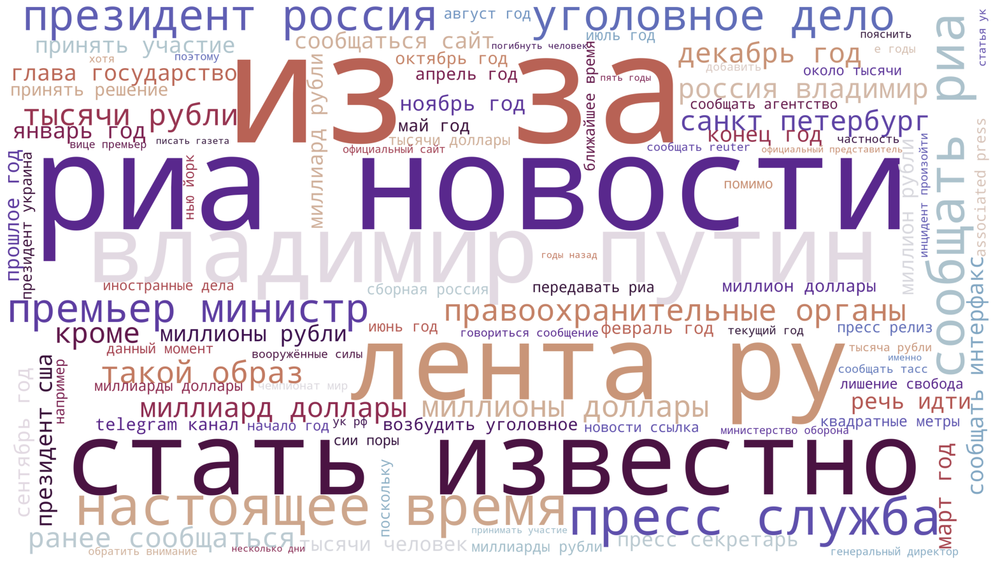

In [7]:
draw_wordcloud(text_string, photo=True, name='pymorphy_wordcloud_full_df')

#### Облако слов по topic

100%|██████████████████████████████████████████████████████████████████████| 241303/241303 [00:01<00:00, 146857.14it/s]


Облако слов для topic "Россия"


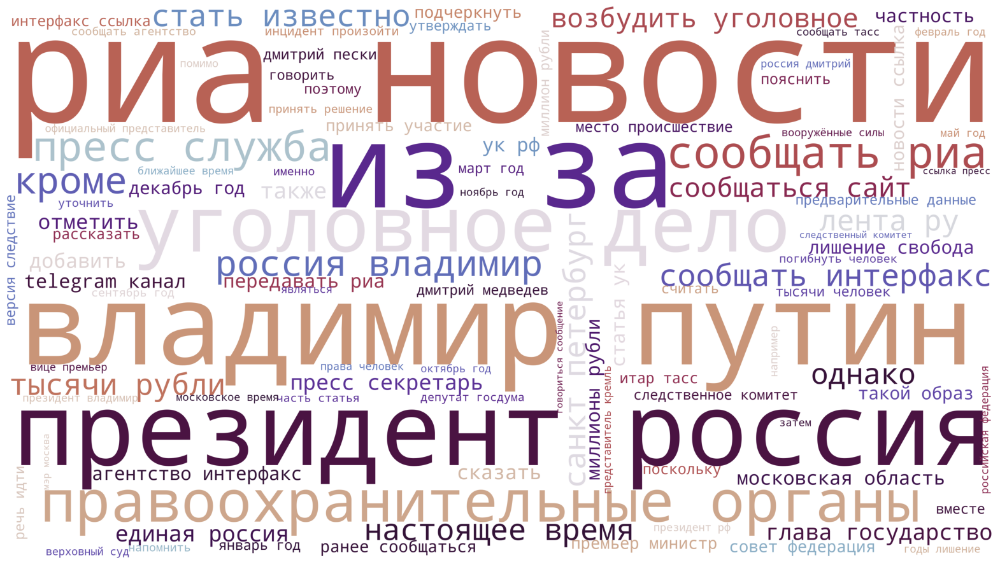

100%|██████████████████████████████████████████████████████████████████████| 195897/195897 [00:01<00:00, 144209.11it/s]


Облако слов для topic "Мир"


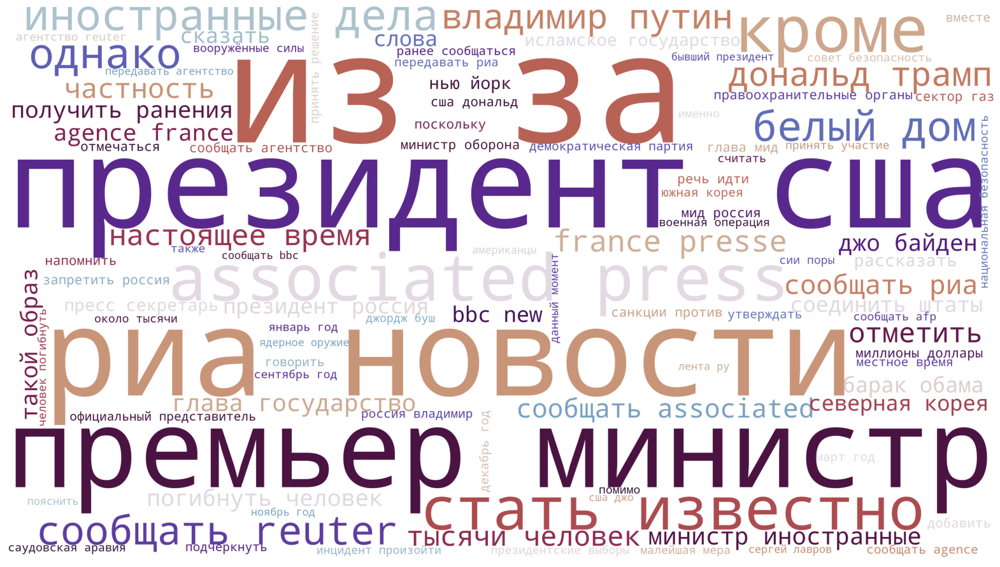

100%|██████████████████████████████████████████████████████████████████████| 122156/122156 [00:00<00:00, 145799.74it/s]


Облако слов для topic "Экономика"


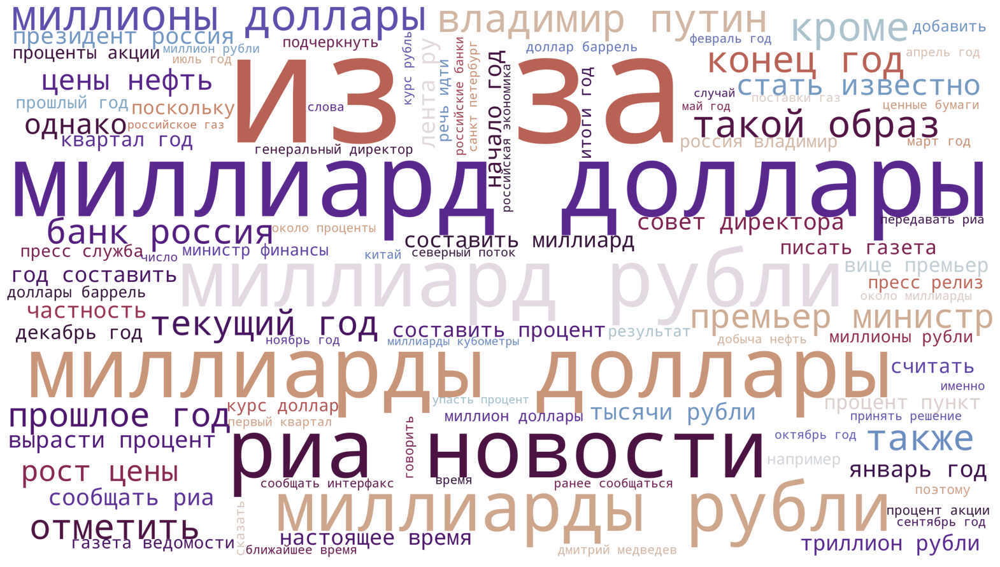

100%|████████████████████████████████████████████████████████████████████████| 93869/93869 [00:00<00:00, 136510.41it/s]


Облако слов для topic "Бывший СССР"


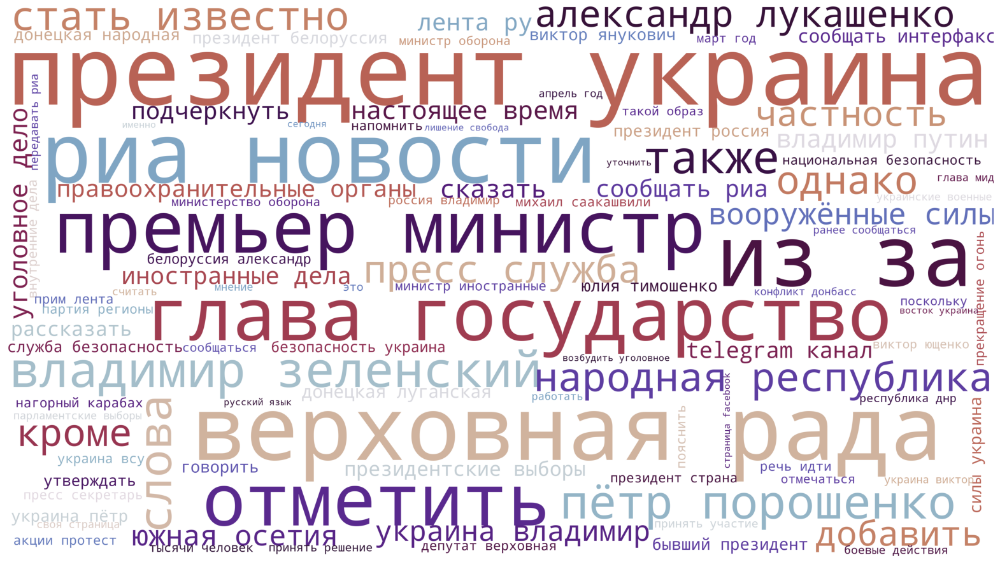

100%|████████████████████████████████████████████████████████████████████████| 91323/91323 [00:00<00:00, 146338.59it/s]


Облако слов для topic "Спорт"


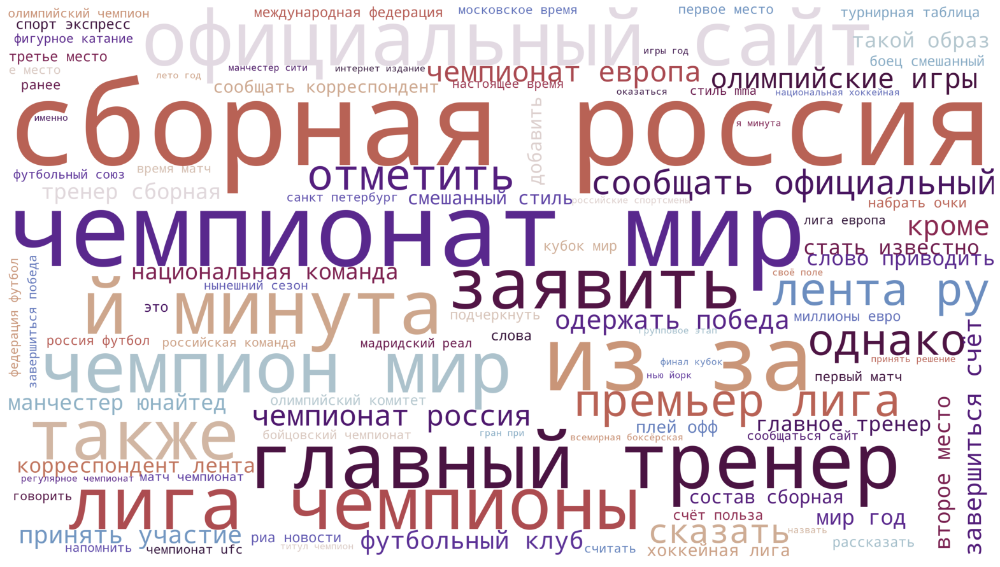

100%|████████████████████████████████████████████████████████████████████████| 75683/75683 [00:00<00:00, 137296.99it/s]


Облако слов для topic "Наука и техника"


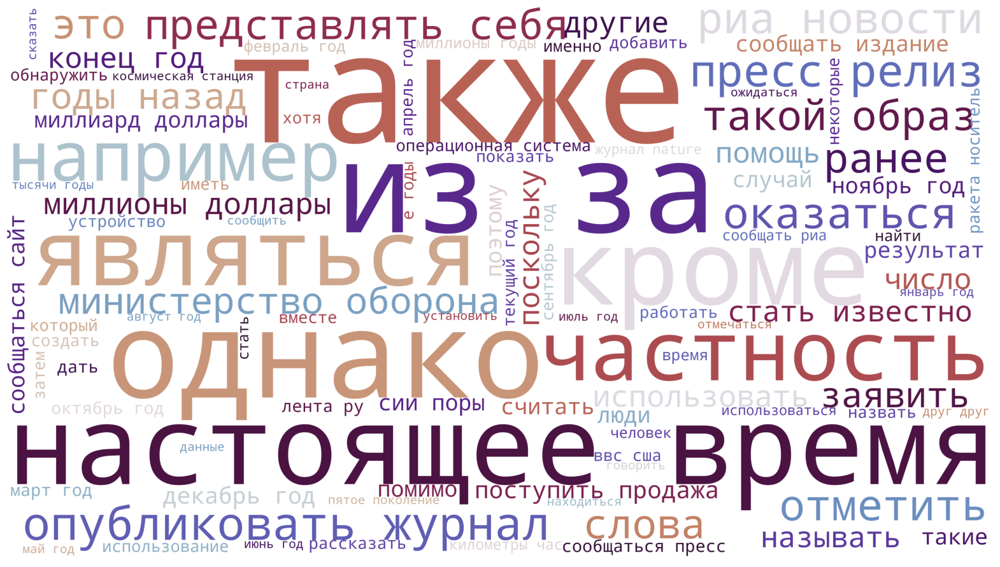

100%|████████████████████████████████████████████████████████████████████████| 71817/71817 [00:00<00:00, 147876.99it/s]


Облако слов для topic "Культура"


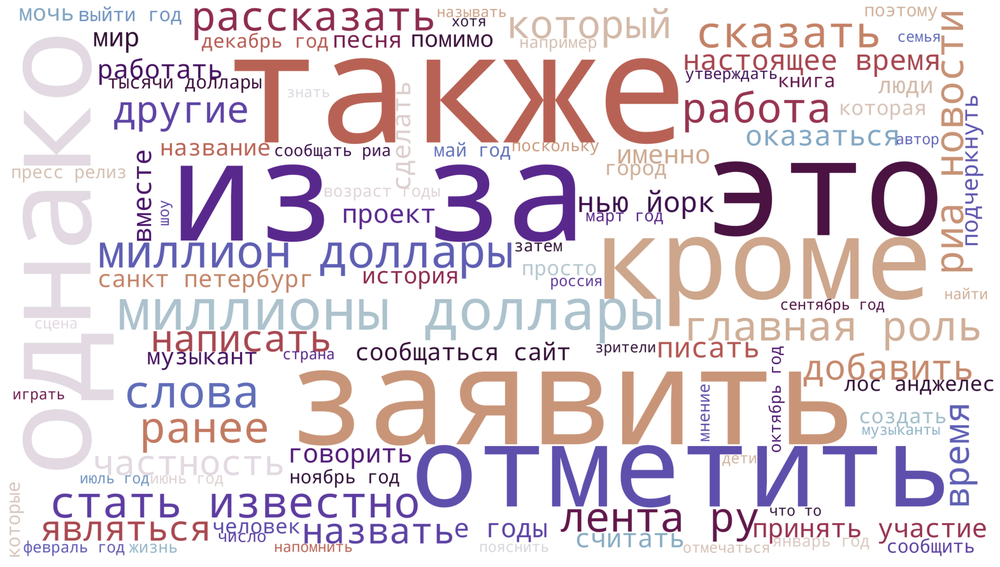

100%|████████████████████████████████████████████████████████████████████████| 64844/64844 [00:00<00:00, 146656.07it/s]


Облако слов для topic "Интернет и СМИ"


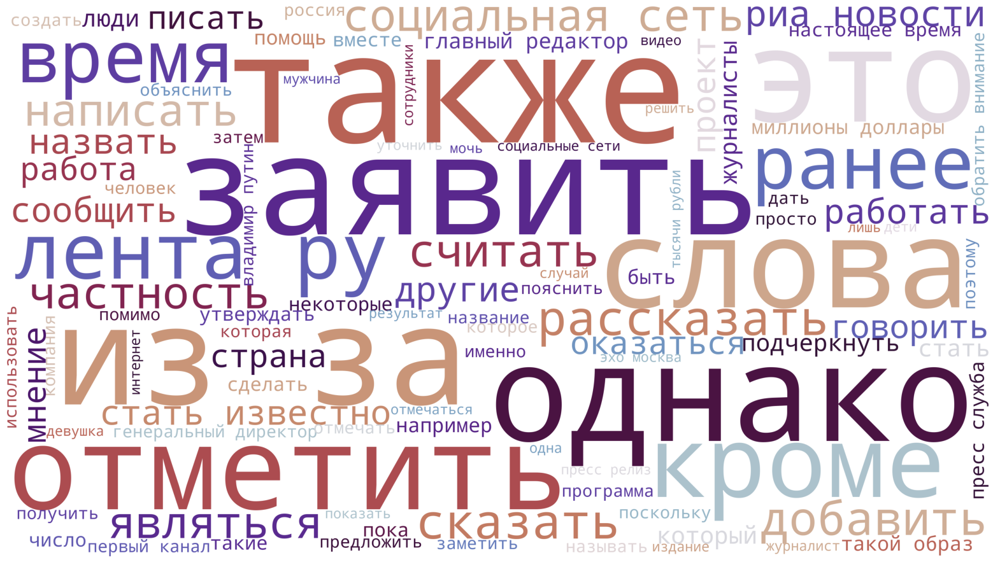

100%|████████████████████████████████████████████████████████████████████████| 44820/44820 [00:00<00:00, 142367.91it/s]


Облако слов для topic "Из жизни"


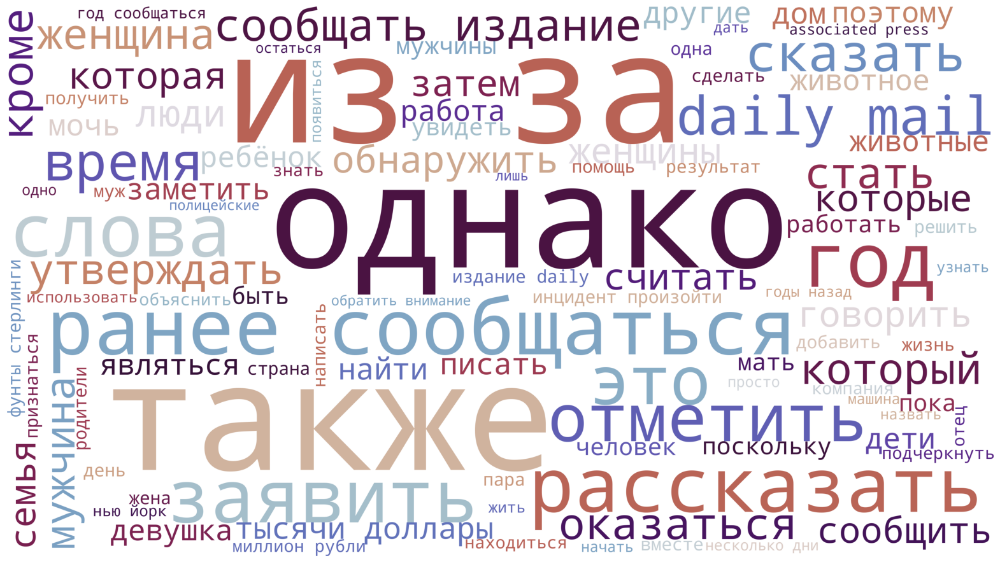

100%|████████████████████████████████████████████████████████████████████████| 43403/43403 [00:00<00:00, 146099.61it/s]


Облако слов для topic "Силовые структуры"


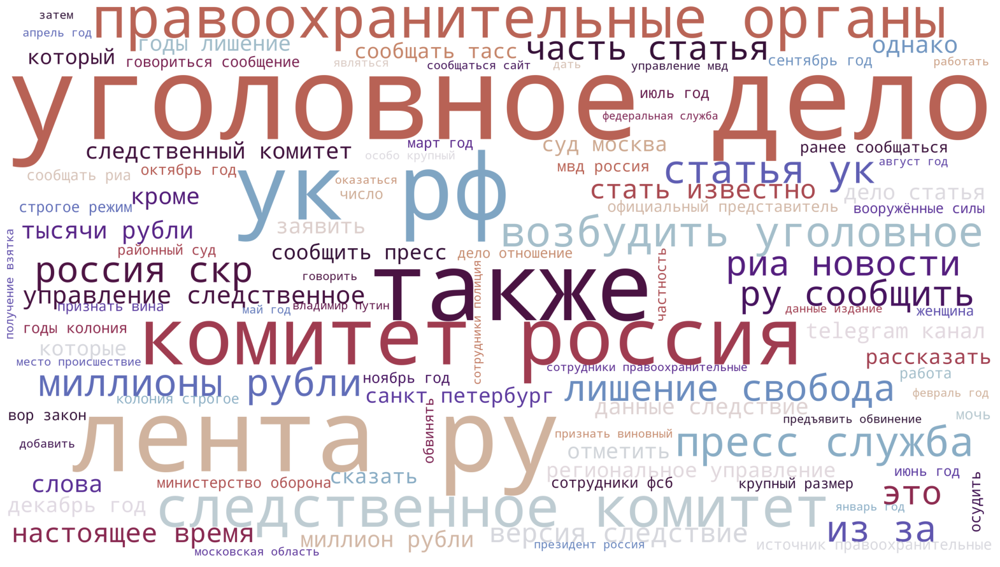

100%|████████████████████████████████████████████████████████████████████████| 22778/22778 [00:00<00:00, 142421.00it/s]


Облако слов для topic "Путешествия"


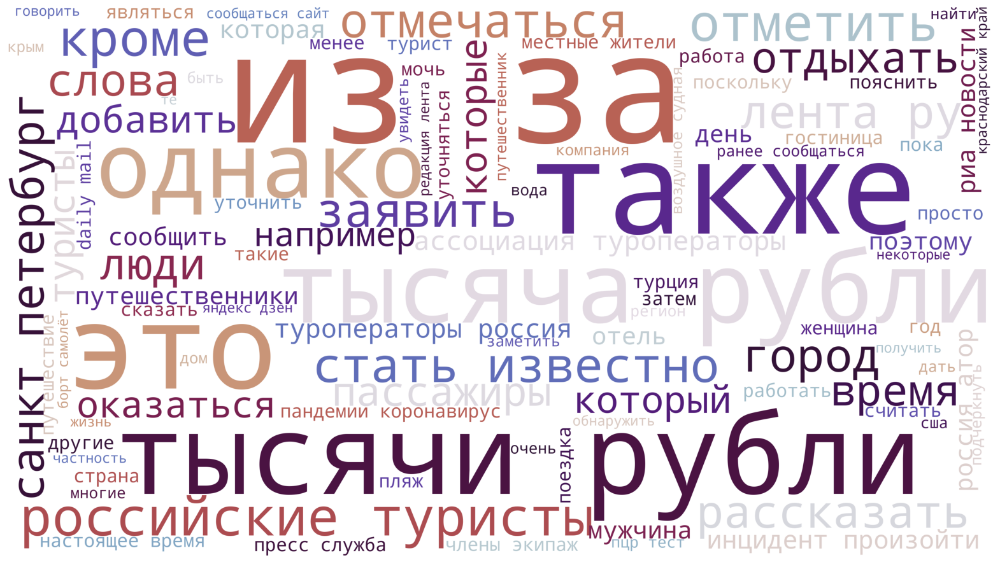

100%|████████████████████████████████████████████████████████████████████████| 22326/22326 [00:00<00:00, 130071.75it/s]


Облако слов для topic "Ценности"


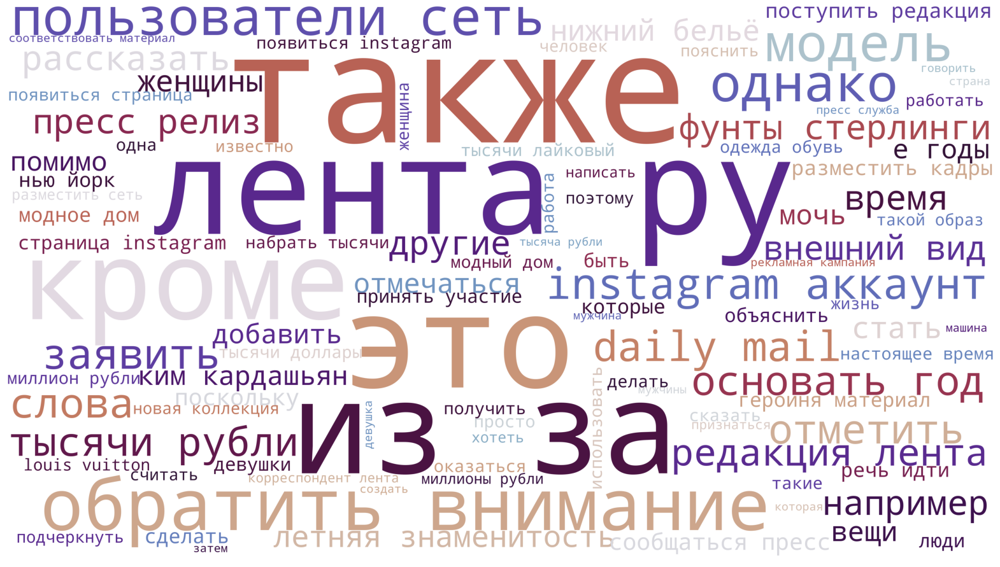

100%|████████████████████████████████████████████████████████████████████████| 22132/22132 [00:00<00:00, 141294.67it/s]


Облако слов для topic "Дом"


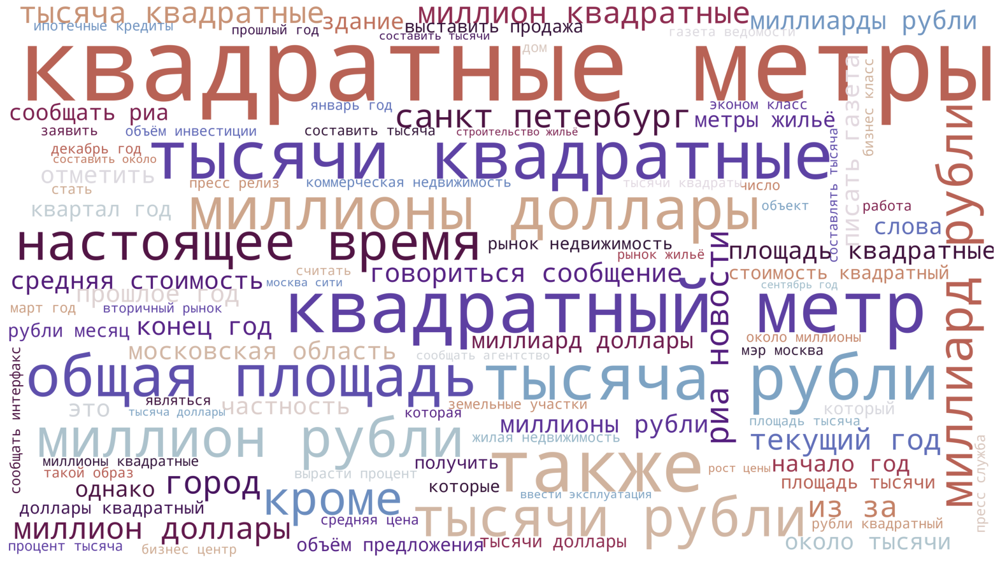

100%|████████████████████████████████████████████████████████████████████████| 15614/15614 [00:00<00:00, 142835.34it/s]


Облако слов для topic "Среда обитания"


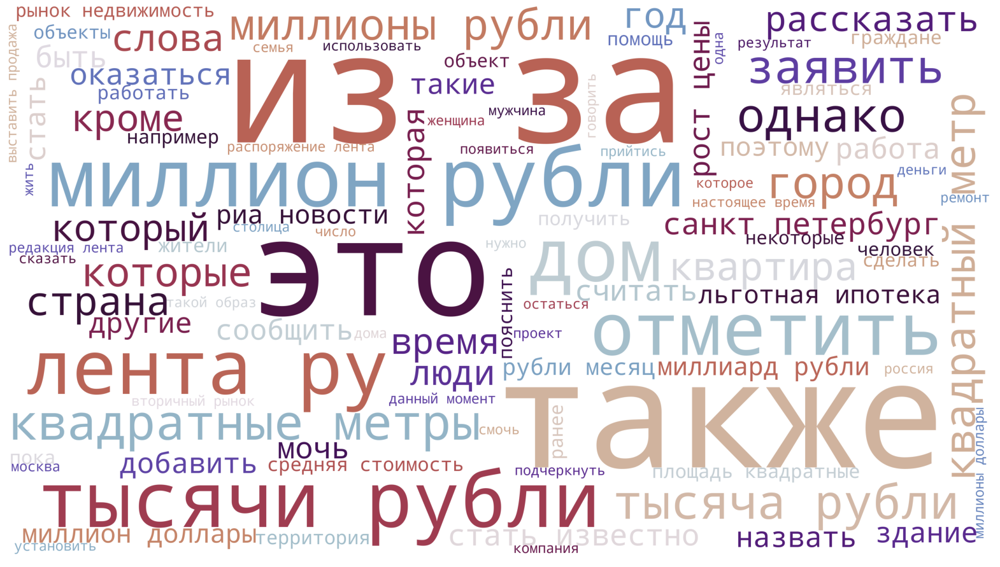

100%|██████████████████████████████████████████████████████████████████████████| 7430/7430 [00:00<00:00, 140998.72it/s]


Облако слов для topic "Бизнес"


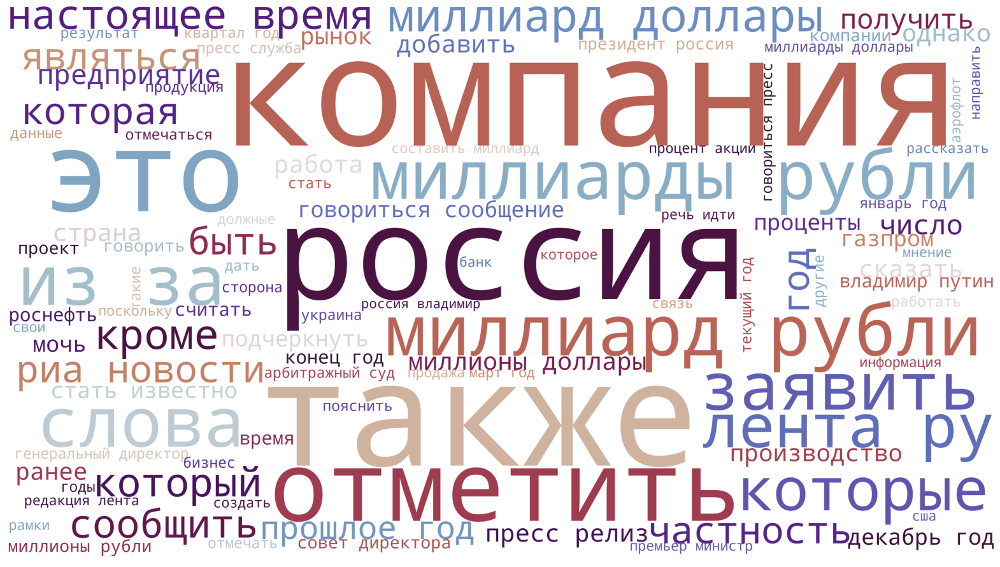

100%|██████████████████████████████████████████████████████████████████████████| 6129/6129 [00:00<00:00, 173325.12it/s]


Облако слов для topic "Моя страна"


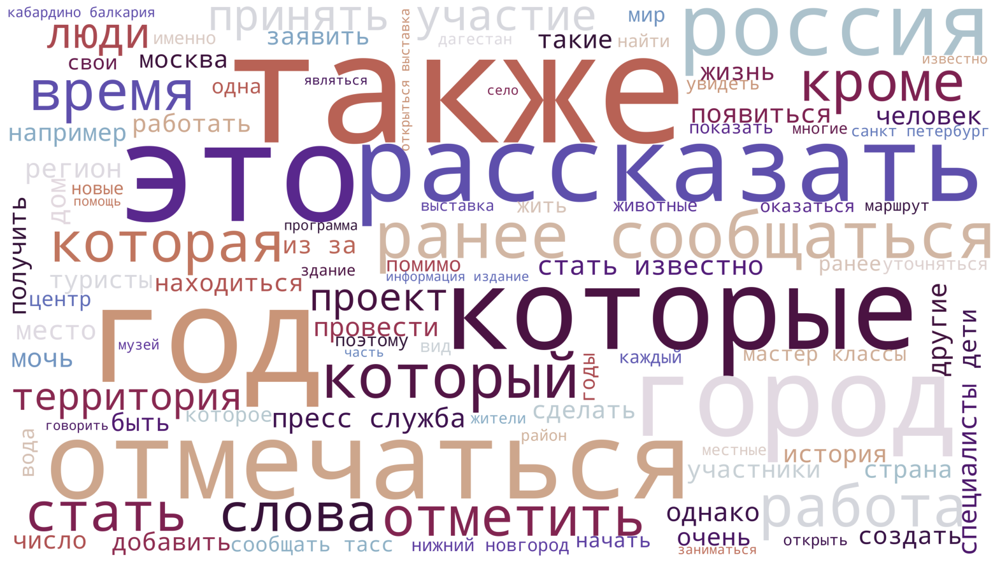

100%|██████████████████████████████████████████████████████████████████████████| 4743/4743 [00:00<00:00, 155536.49it/s]


Облако слов для topic "Нацпроекты"


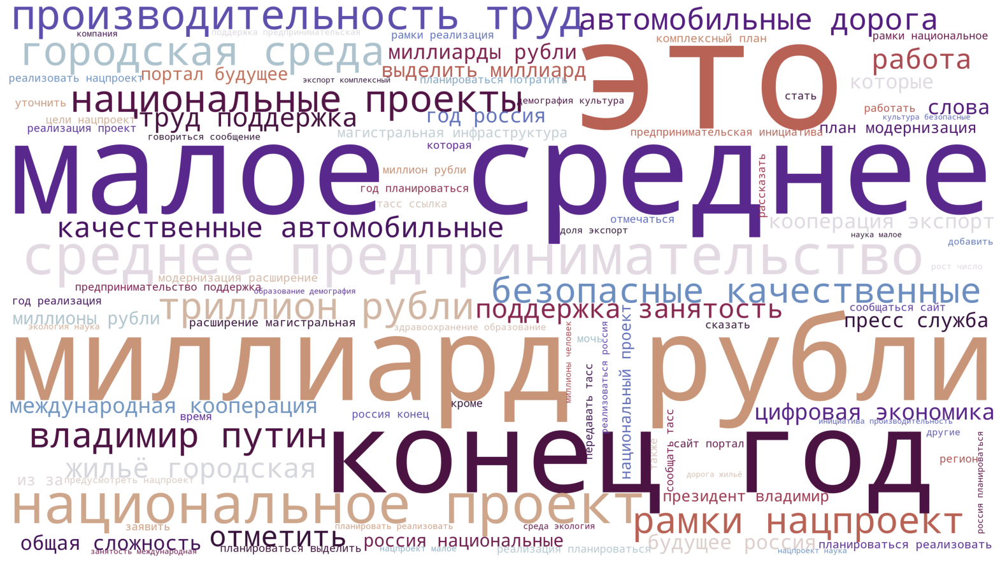

100%|██████████████████████████████████████████████████████████████████████████| 3386/3386 [00:00<00:00, 166708.69it/s]


Облако слов для topic "69-я параллель"


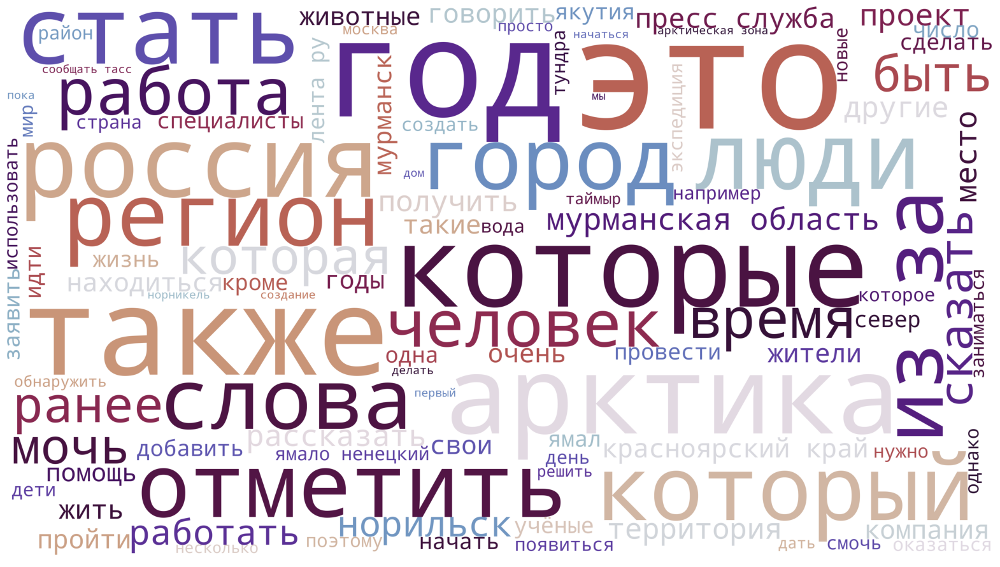

100%|██████████████████████████████████████████████████████████████████████████| 3175/3175 [00:00<00:00, 156382.58it/s]


Облако слов для topic "Забота о себе"


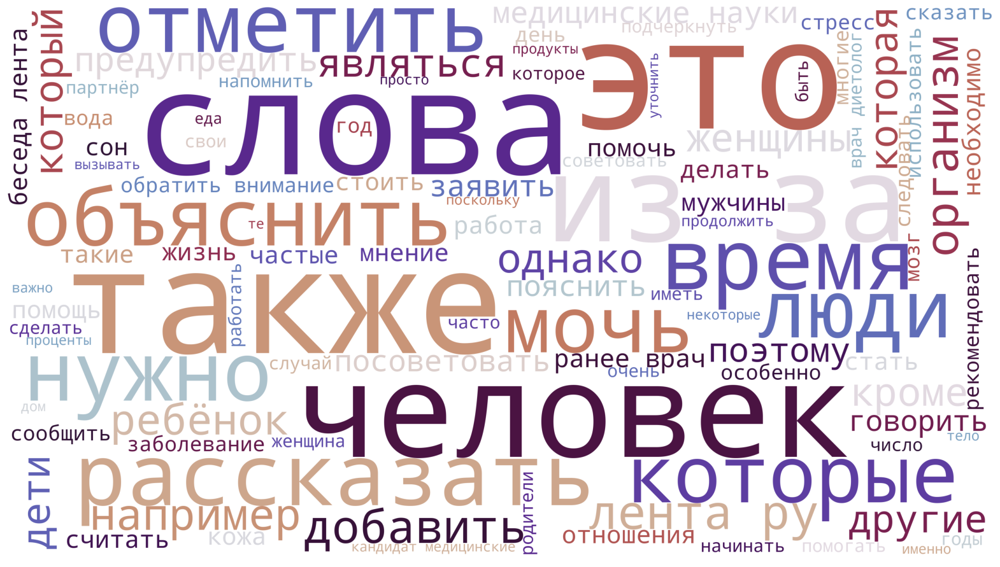

100%|████████████████████████████████████████████████████████████████████████████████████████| 666/666 [00:00<?, ?it/s]


Облако слов для topic "Крым"


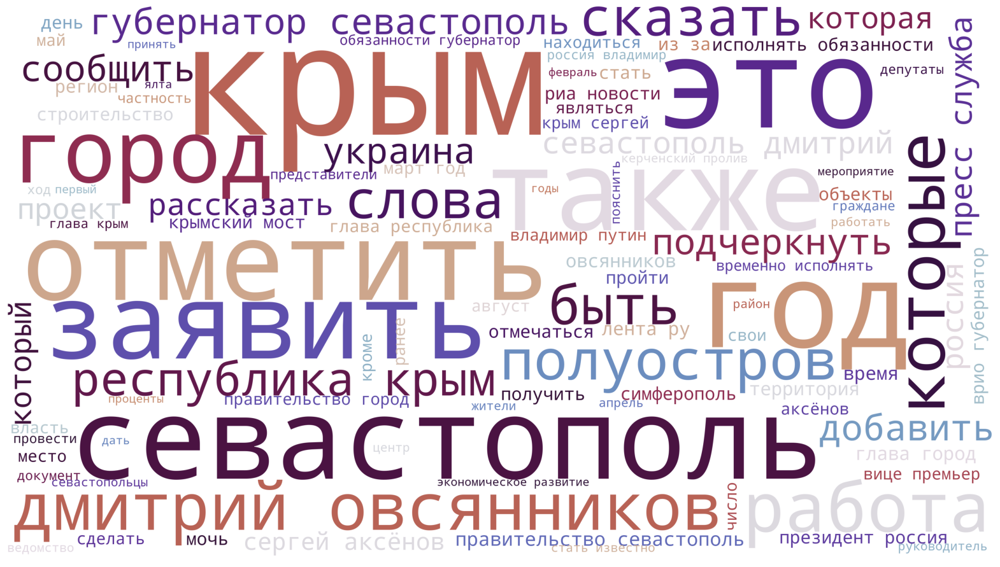

100%|████████████████████████████████████████████████████████████████████████████████████████| 340/340 [00:00<?, ?it/s]


Облако слов для topic "Культпросвет "


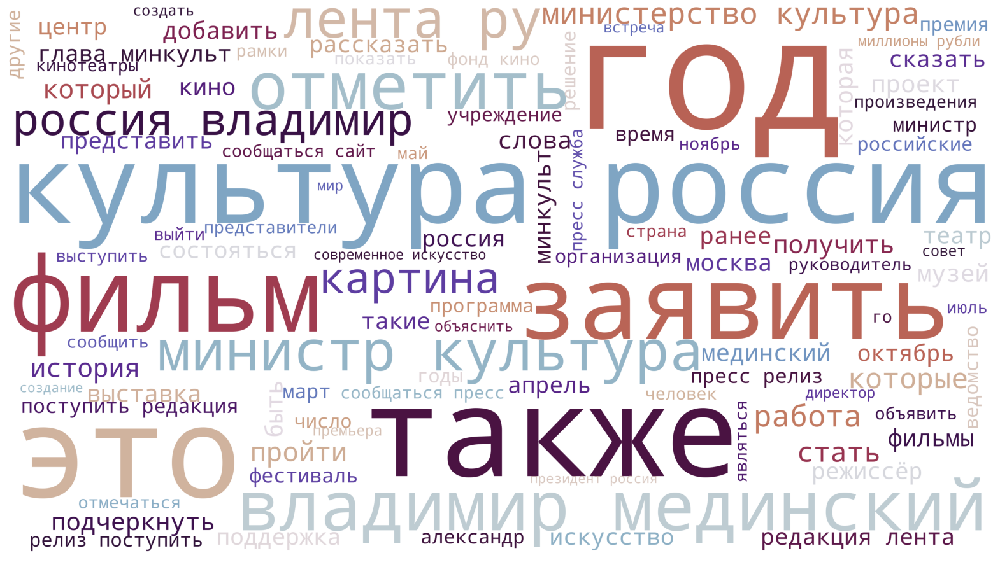

100%|████████████████████████████████████████████████████████████████████████████████████████| 114/114 [00:00<?, ?it/s]


Облако слов для topic "Легпром"


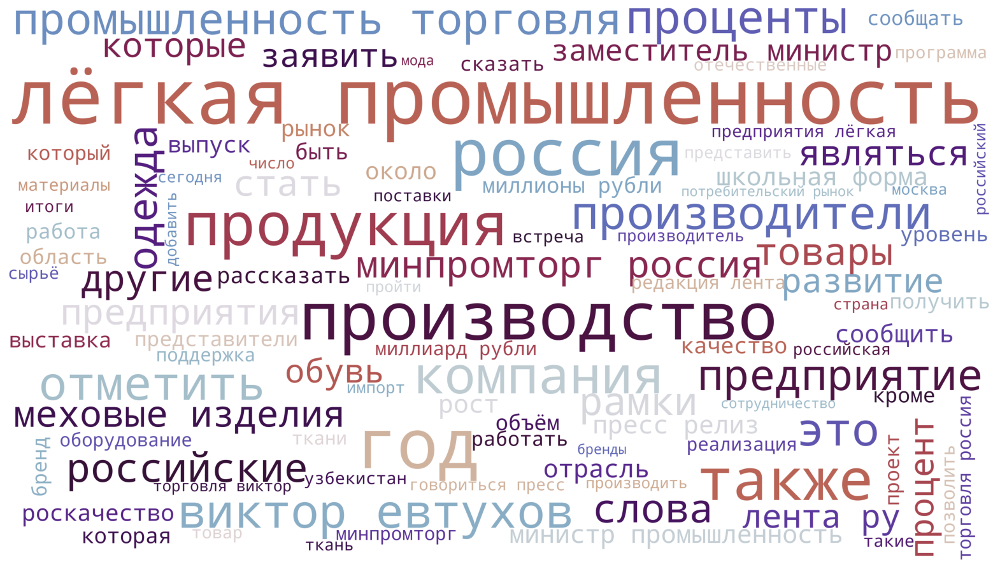

100%|██████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:00<?, ?it/s]


Облако слов для topic "Библиотека"


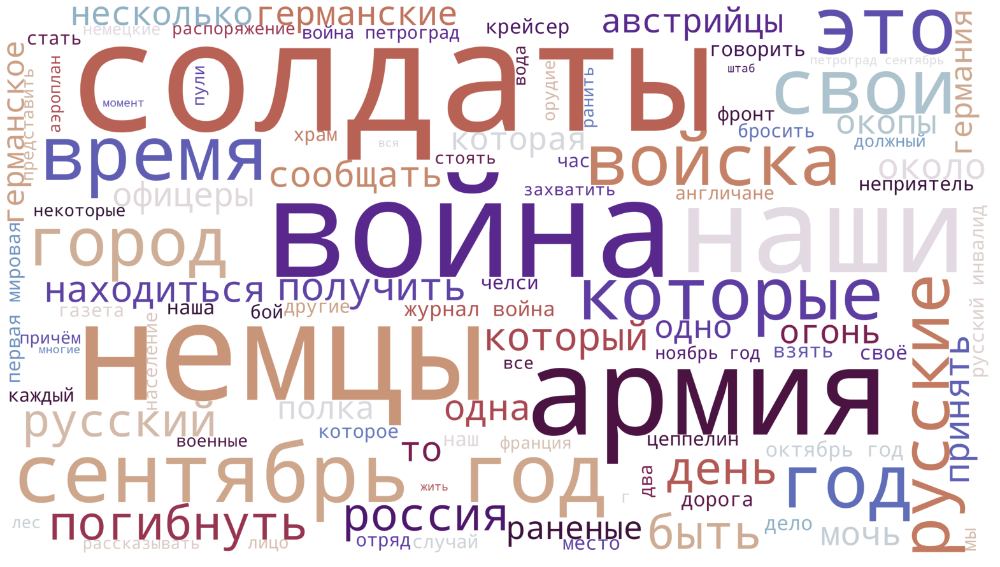

100%|██████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<?, ?it/s]


Облако слов для topic "Оружие"


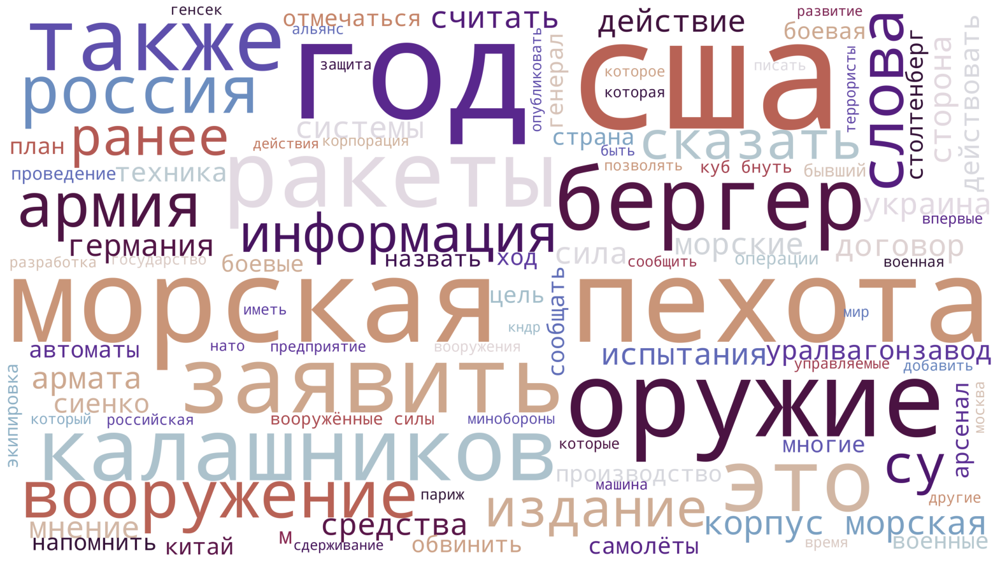

100%|████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<?, ?it/s]


Облако слов для topic "ЧМ-2014"


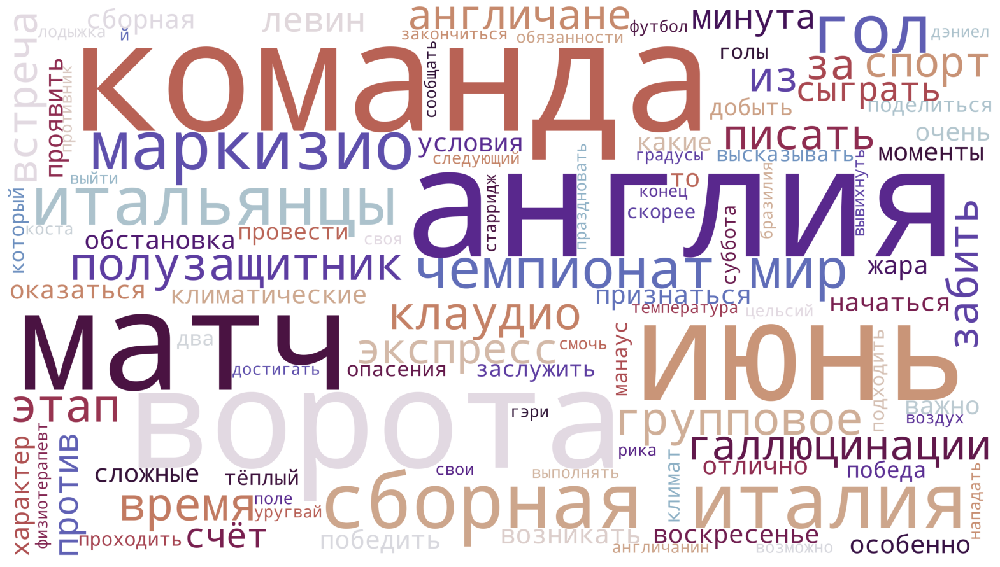

100%|████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<?, ?it/s]


Облако слов для topic "Мотор"


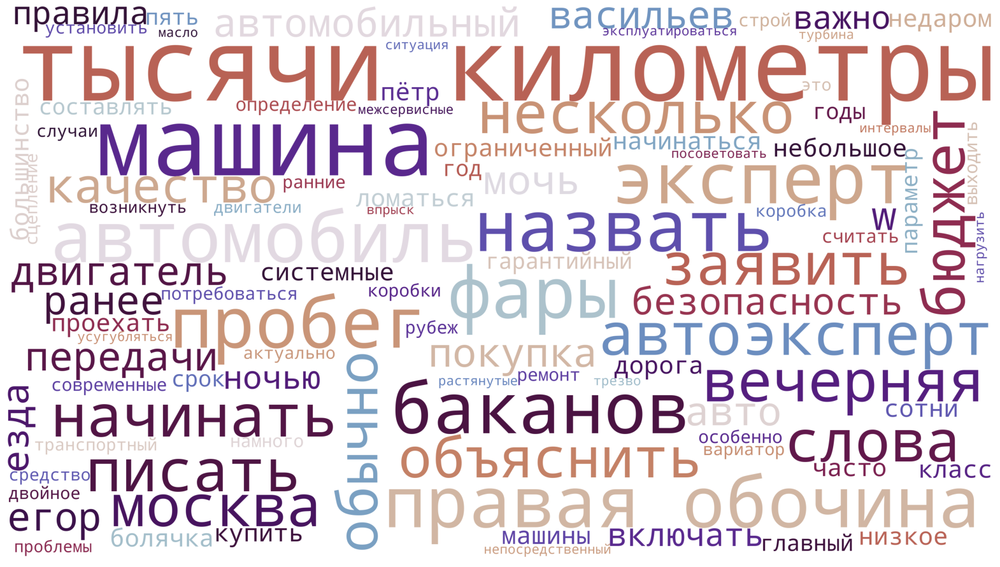

100%|█████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 22795.13it/s]


Облако слов для topic "МедНовости"


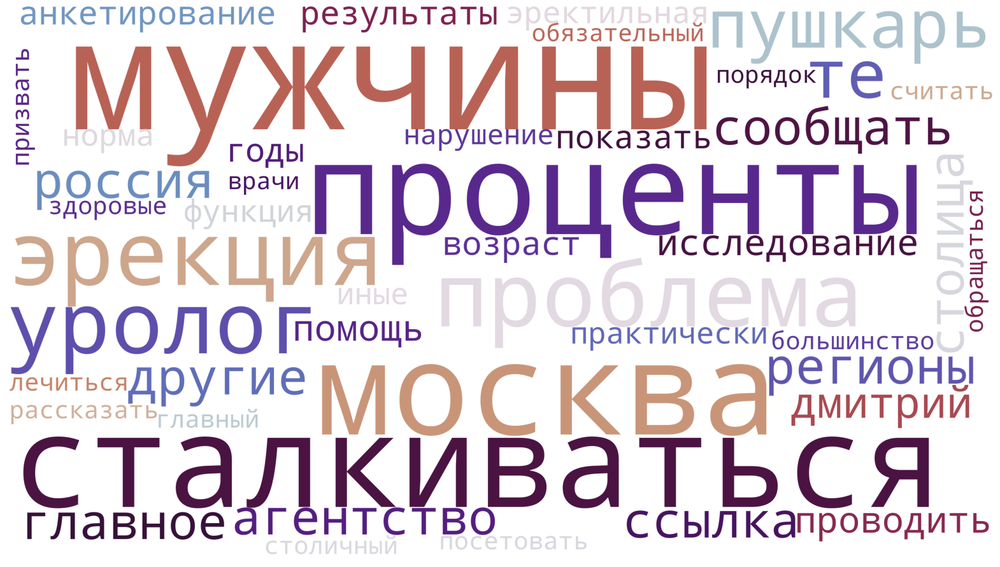

100%|████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<?, ?it/s]


Облако слов для topic "Сочи"


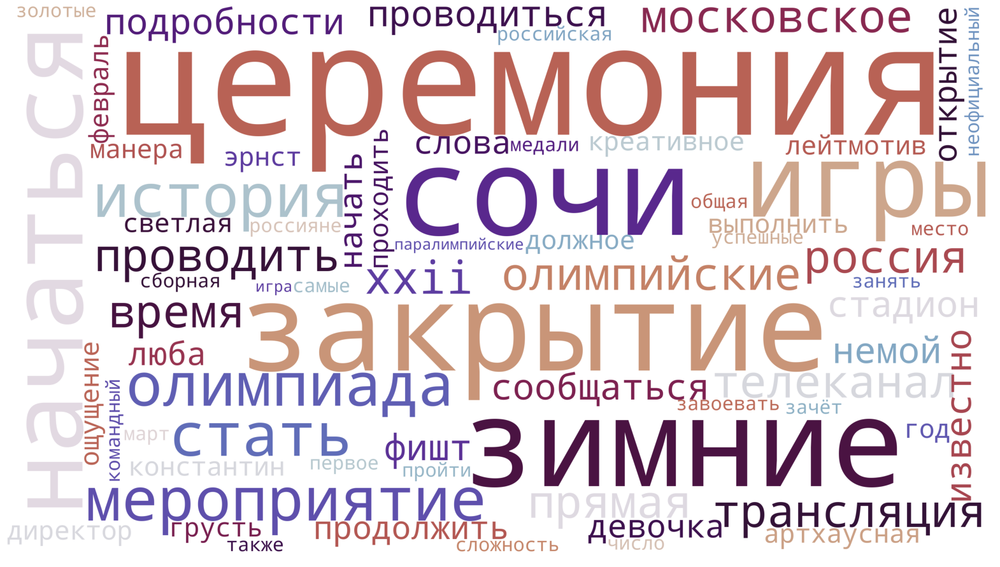

In [13]:
for tp in list(df['topic'].value_counts().index):
    wordcloud_by_topic(tp)

## Мешок слов

### Общий

Посмотрим на общий мешок слов и изучим самые часто встречающиеся слова

In [48]:
list_of_news = [i.split() for i in df.text_str]   
union_list_of_news = list(itertools.chain(*list_of_news))
    
# мешок слов
bow_counter = Counter(union_list_of_news)
bow_counter = sorted(bow_counter.items(), key=lambda item: item[1], reverse=True)

In [49]:
bow_counter[:20]

[('год', 1436210),
 ('россия', 884275),
 ('также', 676185),
 ('это', 580539),
 ('сообщать', 577714),
 ('заявить', 524355),
 ('время', 520395),
 ('которые', 500394),
 ('стать', 490512),
 ('ранее', 408554),
 ('слова', 403755),
 ('который', 394021),
 ('президент', 393935),
 ('страна', 370142),
 ('сша', 363915),
 ('компания', 362359),
 ('человек', 361783),
 ('годы', 345995),
 ('украина', 322695),
 ('которая', 312041)]

### Мешок слов по топику

In [43]:
def bag_of_words_bytopic(topic):
    #обрезка датасета по топику
    df_topic_f = df[df['topic'] == topic]
    list_of_news = [i.split() for i in df_topic_f.text_str]   
    union_list_of_news = list(itertools.chain(*list_of_news))
    
    # мешок слов
    bow_counter = Counter(union_list_of_news)
    bow_counter = sorted(bow_counter.items(), key=lambda item: item[1], reverse=True)
    
    return bow_counter

In [35]:
df['topic'].unique()

array(['Россия', 'Мир', 'Экономика', 'Интернет и СМИ', 'Спорт',
       'Культура', 'Из жизни', 'Силовые структуры', 'Наука и техника',
       'Бывший СССР', nan, 'Дом', 'Сочи', 'ЧМ-2014', 'Путешествия',
       'Библиотека', 'Ценности', 'Легпром', 'Бизнес', 'МедНовости',
       'Оружие', '69-я параллель', 'Культпросвет ', 'Крым',
       'Среда обитания', 'Нацпроекты', 'Моя страна', 'Мотор',
       'Забота о себе'], dtype=object)

In [41]:
df_topic = pd.DataFrame(columns=['topic', 'bag_of_words'])
df_topic

,topic,bag_of_words


In [45]:
for topic in tqdm(df['topic'].unique()):
    bow_counter = bag_of_words_bytopic(topic)
    df_topic.at[len(df_topic), 'topic'] = topic
    df_topic.at[len(df_topic)-1, 'bag_of_words'] = bow_counter

100%|██████████████████████████████████████████████████████████████████████████████████| 29/29 [01:38<00:00,  3.41s/it]


In [46]:
df_topic

,topic,bag_of_words
0,Россия,"[(россия, 242620), (год, 214021), (также, 1405..."
1,Мир,"[(год, 173611), (сша, 171468), (россия, 133725..."
2,Экономика,"[(год, 278364), (россия, 158104), (компания, 1..."
3,Интернет и СМИ,"[(год, 73695), (также, 44326), (компания, 4029..."
4,Спорт,"[(год, 90050), (матч, 78094), (команда, 74224)..."
5,Культура,"[(год, 121894), (фильм, 58195), (стать, 41533)..."
6,Из жизни,"[(год, 41765), (сообщать, 28835), (это, 25230)..."
7,Силовые структуры,"[(год, 62308), (россия, 40336), (дело, 36630),..."
8,Наука и техника,"[(год, 112696), (также, 49026), (которые, 4650..."
9,Бывший СССР,"[(украина, 158985), (президент, 88137), (год, ..."


In [47]:
for i in range(df_topic.shape[0]):
    print('---------------------------------------------')
    print(df_topic['topic'].values[i])
    print(df_topic['bag_of_words'].values[i][:200])

---------------------------------------------
Россия
[('россия', 242620), ('год', 214021), ('также', 140524), ('это', 120289), ('заявить', 118098), ('сообщать', 116945), ('москва', 115350), ('человек', 111996), ('слова', 105052), ('время', 102987), ('которые', 98631), ('президент', 98059), ('ранее', 90976), ('дело', 89405), ('глава', 88574), ('сообщить', 85108), ('область', 80142), ('стать', 77658), ('новости', 73569), ('который', 70287), ('данные', 69674), ('суд', 68789), ('риа', 68438), ('отметить', 65761), ('владимир', 65357), ('рф', 63281), ('путин', 62386), ('годы', 62094), ('находиться', 61482), ('получить', 57553), ('произойти', 55706), ('однако', 54545), ('рубли', 53541), ('которая', 53290), ('тысячи', 52570), ('сообщаться', 51430), ('быть', 51410), ('задержать', 51163), ('рассказать', 50893), ('страна', 50435), ('информация', 50399), ('интерфакс', 49649), ('сказать', 49360), ('люди', 49279), ('место', 48897), ('число', 48236), ('город', 47846), ('работа', 47219), ('решение', 4

### Мешок слов по годам

In [14]:
def bag_of_words_byyear(year):
    #обрезка датасета по топику
    df_topic_f = df[df['date'].dt.year == year]    
    list_of_news = [i.split() for i in df_topic_f.text_str]   
    union_list_of_news = list(itertools.chain(*list_of_news))
    
    # мешок слов
    bow_counter = Counter(union_list_of_news)
    bow_counter = sorted(bow_counter.items(), key=lambda item: item[1], reverse=True)

    return bow_counter

In [15]:
df['date'] = pd.to_datetime(df['date'], format = '%Y-%m-%d')
df['date'].dt.year.unique()

array([1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009,
       2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020,
       2021, 2022], dtype=int64)

In [16]:
df_year = pd.DataFrame(columns=['year', 'bag_of_words'])
df_year

,year,bag_of_words


In [17]:
for year in df['date'].dt.year.unique():
    bow_counter = bag_of_words_byyear(year)
    df_year.at[len(df_year), 'year'] = year
    df_year.at[len(df_year)-1, 'bag_of_words'] = bow_counter

In [18]:
df_year

,year,bag_of_words
0,1999,"[(россия, 2606), (год, 2380), (сообщать, 1676)..."
1,2000,"[(год, 9028), (россия, 8348), (сообщать, 7302)..."
2,2001,"[(год, 13807), (сообщать, 13460), (россия, 950..."
3,2002,"[(год, 16531), (сообщать, 15167), (россия, 126..."
4,2003,"[(год, 16563), (сообщать, 13325), (заявить, 11..."
5,2004,"[(год, 23225), (заявить, 14406), (время, 13269..."
6,2005,"[(год, 34949), (сообщать, 17708), (россия, 176..."
7,2006,"[(год, 40147), (сообщать, 22226), (россия, 187..."
8,2007,"[(год, 44725), (сообщать, 22191), (россия, 178..."
9,2008,"[(год, 67310), (сообщать, 34039), (также, 2481..."


In [19]:
for i in range(df_year.shape[0]):
    print('---------------------------------------------')
    print(df_year['year'].values[i])
    print(df_year['bag_of_words'].values[i][:200])

---------------------------------------------
1999
[('россия', 2606), ('год', 2380), ('сообщать', 1676), ('время', 1577), ('также', 1495), ('сообщить', 1453), ('заявить', 1366), ('это', 1351), ('новости', 1293), ('москва', 1259), ('которые', 1147), ('риа', 1142), ('президент', 1114), ('сша', 1054), ('слова', 1030), ('правительство', 1027), ('решение', 999), ('суд', 953), ('компания', 934), ('человек', 914), ('однако', 890), ('быть', 865), ('доллары', 827), ('принять', 804), ('агентство', 785), ('рф', 778), ('выборы', 741), ('чечня', 738), ('информация', 730), ('стать', 722), ('который', 713), ('тысячи', 712), ('данные', 697), ('дело', 694), ('находиться', 686), ('связь', 663), ('российские', 662), ('глава', 648), ('владимир', 647), ('декабрь', 642), ('страна', 640), ('отметить', 632), ('получить', 621), ('министр', 620), ('около', 617), ('город', 614), ('являться', 613), ('которая', 606), ('представители', 605), ('свои', 594), ('миллионы', 591), ('другие', 583), ('мнение', 577), ('годы

### мешок слов по месяцам

In [20]:
def bag_of_words_bymonth(month):
    #обрезка датасета по топику
    df_topic_f = df[df['date'].dt.month == month]
    list_of_news = [i.split() for i in df_topic_f.text_str]   
    union_list_of_news = list(itertools.chain(*list_of_news))
    
    # мешок слов
    bow_counter = Counter(union_list_of_news)
    bow_counter = sorted(bow_counter.items(), key=lambda item: item[1], reverse=True)
    
    return bow_counter

In [21]:
df['date'].dt.month.unique()

array([ 8,  9, 10, 11, 12,  1,  2,  3,  4,  5,  6,  7], dtype=int64)

In [22]:
df_month = pd.DataFrame(columns=['month', 'bag_of_words'])
df_month

,month,bag_of_words


In [23]:
for month in df['date'].dt.month.unique():
    bow_counter = bag_of_words_bymonth(month)
    if month == 1:
        month01 = "январь"
    elif month == 2:
        month01 = "февраль"
    elif month == 3:
        month01 = "март"
    elif month == 4:
        month01 = "апрель"
    elif month == 5:
        month01 = "май"
    elif month == 6:
        month01 = "июнь"
    elif month == 7:
        month01 = "июль"
    elif month == 8:
        month01 = "август"
    elif month == 9:
        month01 = "сентября"
    elif month == 10:
        month01 = "октябрь"
    elif month == 11:
        month01 = "ноябрь"
    elif month == 12:
        month01 = "декабрь"
    df_month.at[len(df_month), 'month'] = month01
    df_month.at[len(df_month)-1, 'bag_of_words'] = bow_counter

In [24]:
df_month

,month,bag_of_words
0,август,"[(год, 114005), (август, 72782), (россия, 7160..."
1,сентября,"[(год, 117911), (россия, 80820), (сентябрь, 75..."
2,октябрь,"[(год, 127394), (россия, 82514), (октябрь, 780..."
3,ноябрь,"[(год, 121474), (россия, 71783), (ноябрь, 7021..."
4,декабрь,"[(год, 134606), (россия, 74213), (декабрь, 703..."
5,январь,"[(год, 120676), (январь, 64961), (россия, 5724..."
6,февраль,"[(год, 119390), (россия, 69383), (февраль, 648..."
7,март,"[(год, 121057), (россия, 81080), (март, 77177)..."
8,апрель,"[(год, 119727), (россия, 78850), (апрель, 7210..."
9,май,"[(год, 108302), (россия, 68973), (май, 68671),..."


In [25]:
for i in range(df_month.shape[0]):
    print('---------------------------------------------')
    print(df_month['month'].values[i])
    print(df_month['bag_of_words'].values[i][:200])

---------------------------------------------
август
[('год', 114005), ('август', 72782), ('россия', 71607), ('также', 58616), ('сообщать', 50706), ('это', 49685), ('время', 45118), ('заявить', 44123), ('которые', 44096), ('стать', 42600), ('ранее', 36876), ('слова', 35027), ('который', 34411), ('страна', 32306), ('компания', 31791), ('человек', 31528), ('сша', 31038), ('годы', 29840), ('президент', 29760), ('которая', 27604), ('однако', 25841), ('сообщить', 25771), ('получить', 25414), ('украина', 25326), ('москва', 24203), ('отметить', 23757), ('рубли', 23726), ('данные', 23667), ('тысячи', 22915), ('глава', 22773), ('проценты', 22750), ('находиться', 22073), ('доллары', 21380), ('сообщаться', 21246), ('июль', 21201), ('мочь', 20867), ('из-за', 20591), ('город', 20222), ('несколько', 20138), ('дело', 19645), ('быть', 19632), ('рассказать', 19156), ('место', 19134), ('информация', 18744), ('являться', 18721), ('около', 18700), ('суд', 18637), ('работа', 18518), ('процент', 18162), ('д

**Выводы**

Как и для обработки текстов с помощью `mystem`, так и для текстов, обработанных `pymorphy` мы решили проанализировать наиболее популярные слова в разных разрезах. Для этого делался так называемый «мешок слов» - количество употребления в тексте каждого слова. Мешки слов делались по всему датафрейму, по топикам, по годам и месяцам.  
Также это бы помогло сравнить 2 обработки.

Результаты получились в принципе такие же, как и в обработке mystem.
Здесь можно добавить, что присутствие в большом кол-ве на всем датафрейме таких слов как «россия», «президент», «сша», «страна» объясняется тем, что наиболее представленными категориями в выборке были: Россия, Мир, Экономика, Бывший СССР и тд.

Остальные выводы по мешку слов можно прочитать в файле Mystem_and_bag_of_words.ipybn